# Edge Detection 

The purpose of this assignment is to use computer vision to extract specific features from images. In particular, we're going to see if we can find text. We are not interested in finding whole words right now; we'll look at how to find whole words in a coming class. For now, we only want to find language-like objects, such as letters and punctuation.



Download and save the image at the link below:



https://upload.wikimedia.org/wikipedia/commons/f/f4/%22We_Hold_These_Truths%22_at_Jefferson_Memorial_IMG_4729.JPG


__The assignment contains 4 tasks:__ 

1) Draw a green rectangular box to show a region of interest (ROI) around the main body of text in the middle of the image. Save this as image_with_ROI.jpg.

2) Crop the original image to create a new image containing only the ROI in the rectangle. Save this as image_cropped.jpg.

3) Using this cropped image, use Canny edge detection to 'find' every letter in the image.  

4) Join the contours around each letter in the cropped image to give defined letters. Save this as image_letters.jpg


Extensions 1 and 2 will be explained in detail below. 

In [1]:
#Packages 
import os   
import sys  
sys.path.append(os.path.join(".."))

#impage processing
import cv2
import numpy as np

#display 
from utils.imutils import jimshow
import matplotlib.pyplot as plt

import matplotlib as mpl

#Argparse 
import argparse

In [19]:
#Jimshow_channel function (in case it's not in your folder)
def jimshow_channel(image, title=False):
    """
    Modified jimshow() to plot individual channels
    """
    # Acquire default dots per inch value of matplotlib
    dpi = mpl.rcParams['figure.dpi']
    height, width = image.shape
    figsize = width / float(dpi), height / float(dpi)
    plt.figure(figsize=figsize)
    plt.imshow(image, cmap='gray')
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

In [4]:
#Loading in our image 
fname = os.path.join("..", "Image_Edge_Detection", "Images", "weholdtruths.jpeg")
image = cv2.imread(fname)

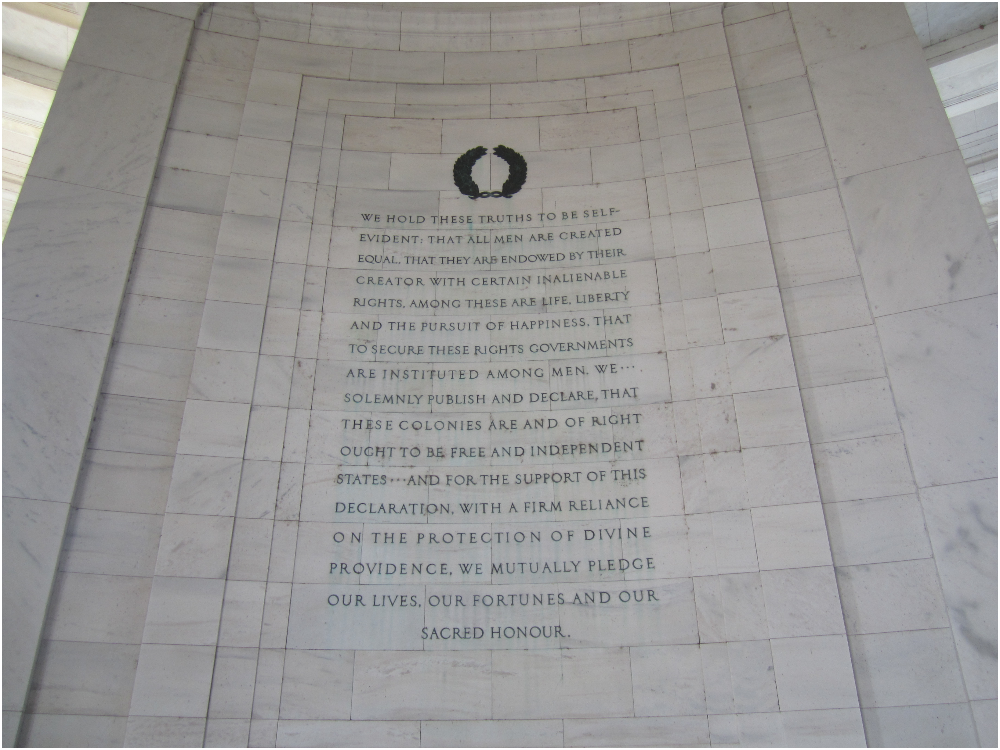

In [5]:
#Let's first take a look at what we're working with
jimshow(image)

In [6]:
#We're interested in cropping the image down to our area of interest so we'll use shape to determine the dimensions 
image.shape

(3240, 4320, 3)

__Part 1: Determining the Region of Interest (ROI)__

We want to identify our region of interest by drawing a green rectangle around the body of text 

Code explanations: To avoid ammending the original image, we use a copy of it by typing .copy() after calling the image 

We then determine where the border should be using 255 in the green colour channel: 

ROI_image = cv2.rectange(copy_of_image, (starting_point x, y), (end_point x, y), (colour_channels), (line_width))

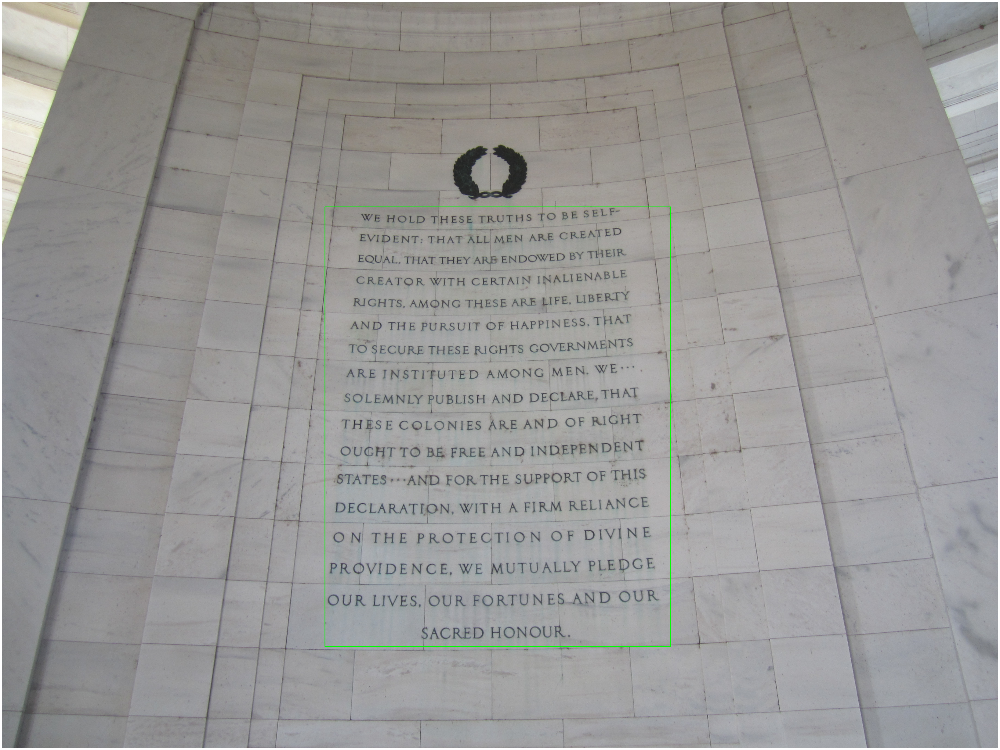

In [10]:
ROI_image = cv2.rectangle(image.copy(), (1400,890), (2900,2800), (0,255,0), (2))
jimshow(ROI_image) #see how it fits - nice! 

In [15]:
#Now we have our border, we want to save the image 
cv2.imwrite("image_with_ROI.jpg", ROI_image)

True

__Cropping the Image__

We can do this simply since we know the co-ordinates by treating the image as a numpy and slicing it across x & y axis

The equation for this is: 

ROI = image[startY:endY, startX:endX]
 

In [22]:
Cropped_ROI = image[890:2800, 1400:2900]

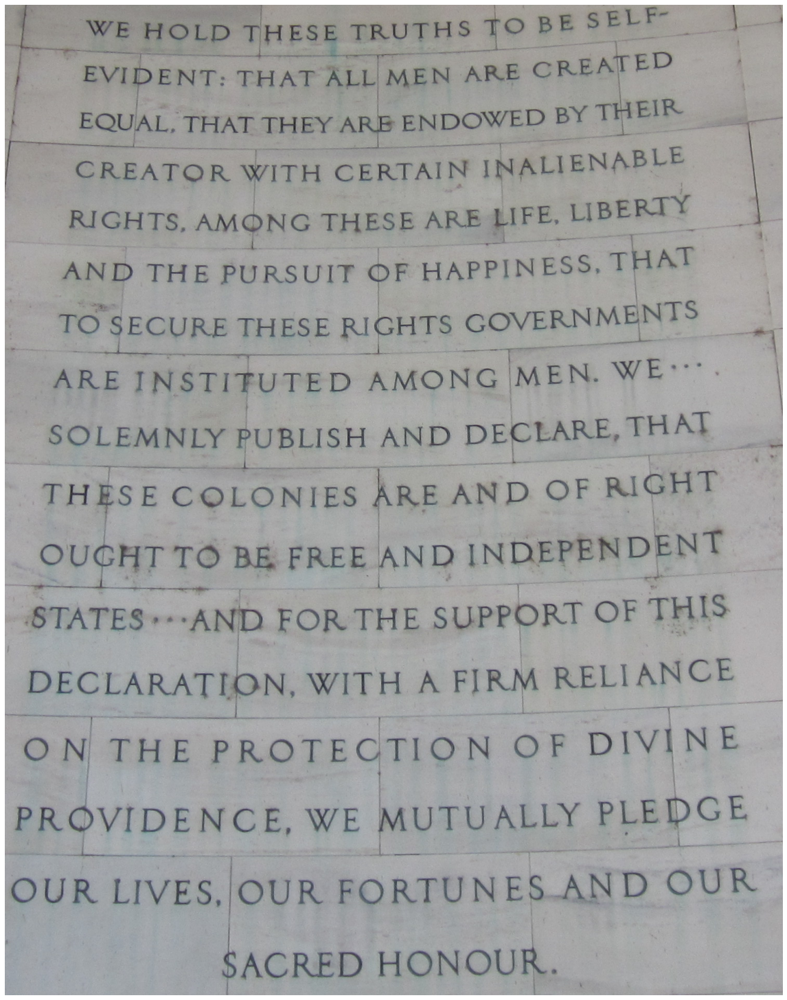

In [23]:
jimshow(Cropped_ROI) #Now we only have the region which holds the letters 

In [24]:
#We'll save this as a new image called image_cropped.jpg
cv2.imwrite("image_cropped.jpg", Cropped_ROI)

True

__Canny Edge Detection__

Canny edge detection can be used to find the letters within the text. This works best after a gaussian blur has been applied to the image to reduce the effect of high definition edges. 

In [ ]:
#Creating a blurred image of the cropped ROI 
blurred_image = cv2.GaussianBlur(Cropped_ROI, (7,7), 0)

In [33]:
#Applying our binary threshold to make the image black and white ((this helps to segment foreground and background)
(_, binary_image) = cv2.threshold(blurred_image, 110, 255, cv2.THRESH_BINARY)

In [ ]:
#apply cv2's canny edge detection (We've manually set the parameters) 
canny_image = cv2.Canny(binary_image, 60, 150)

In [ ]:
jimshow_channel(canny_image)

__Finally we'll find the contours to turn the edges into full letters joined together__

In [ ]:
# finding contours
#This can be read as:  cv2.findContours(image_copy, contour_retrieval_mode, contour_approximation_method)
(contours, _) = cv2.findContours(canny_image.copy(), 
                                     cv2.RETR_EXTERNAL, 
                                     cv2.CHAIN_APPROX_SIMPLE)

In [ ]:
# drawing contours on cropped image with thickness of 2 (using copy of cropped image) 
letters_image = cv2.drawContours(Cropped_ROI.copy(), contours, -1, (0,255,0), 2)

In [ ]:
#See how the letters image looks 
jimshow_channel(letters_image)

In [ ]:
cv2.imwrite("image_letters.jpg", letters_image)

## Part 2: Generalizing the edge detection

It's great to be able to manually find the ROI of images and use this to find the contours of text on one image, but the task quickly becomes cumbersome if we have a collection of text images we want to find the contours of. Say for example, we're looking at cultural graffiti from around the world and we want to be able to detect the messages hidden among paint-stricken walls. How well will our method generalise here?  

The below script is part of an exploratory extension, looking at how we could make a more generalizable script to read images of cultural graffiti. 5 images have been seleted from areas commonly known for their political graffiti and streetart. Due to the exploratory nature of this extension, there's no promises on how good the results will be! 

___The Image collection: Cultural Graffiti___

___Berlin___ = This image is taken from the Eastside Gallery in Belin. It captures text written on the Berlin Wall not long after it fell reading: "A few more walls like this should fall"

___Bosnia___ = This image is taken from Sarajevo, the captial of Bosnia. The image displays a soldier claiming to defend the city.

___Northern Ireland___ = This image was taken after the peace treaty in Northern Ireland and displays text on a gate which reads "There never was a good war or a bad peace"

___US___ = This image is taken from the Black Lives Matter movement in the US which flared up in 2020.

___Syria___ = This image is taken from a collapsed building in Syria, where a local street artist leaves powerful messages, surprisingly in English.

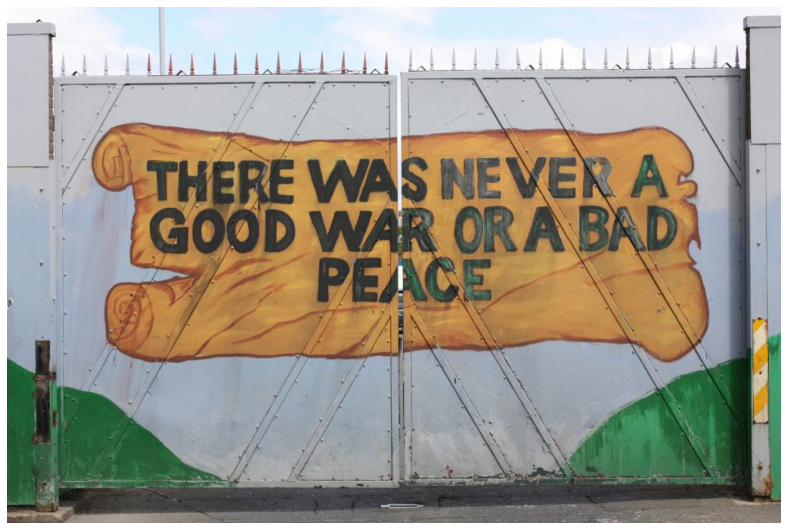

In [46]:
#Let's start with my home country's image: Northern Ireland 
NI_fname = os.path.join("..", "Image_Edge_Detection", "Images", "N_Ireland.jpeg")
NI_image = cv2.imread(NI_fname)

#Let's take a look 
jimshow(NI_image)

In [47]:
NI_image.shape

(683, 1024, 3)

This image is much smaller, with H = 683 and W = 1024. There's also a lot of extra details in the background, with the lines and details of the gate and the spikes on the top. Moreover, the text is wider. How should we find the ROI? 

The image looks about a quarter of the way down the height and takes up the majority of the width so we'll go wide with out estimations

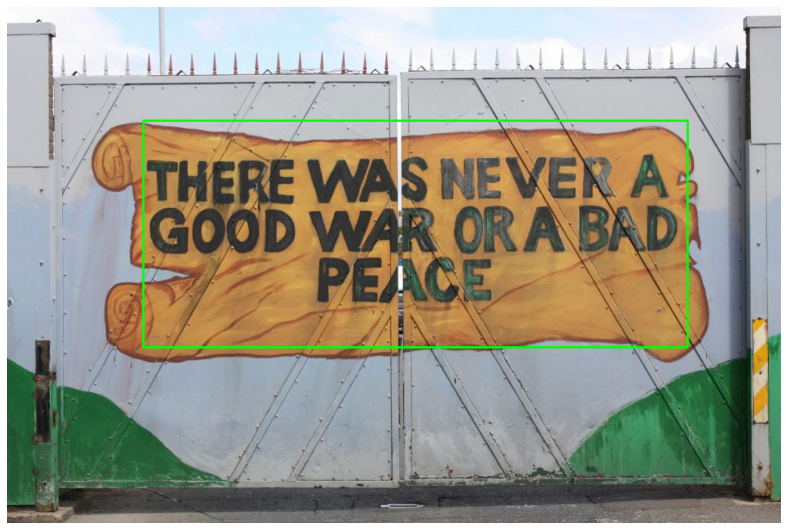

In [48]:
#We'll try to find this images ROI 
NI_ROI = cv2.rectangle(NI_image.copy(), (180,150), (900,450), (0,255,0), (2))
jimshow(NI_ROI) #see how it fits - nice!

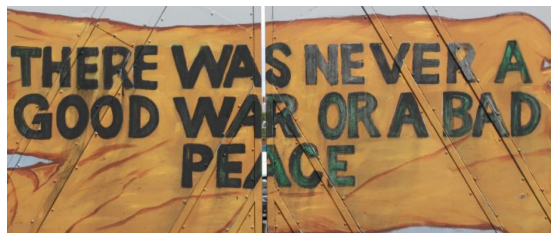

In [49]:
#Once we've found an ROI we're happy with, we can crop the image 
Cropped_NI = NI_image[150:450, 180:900]
jimshow(Cropped_NI)  #Nice, we have our region now. 

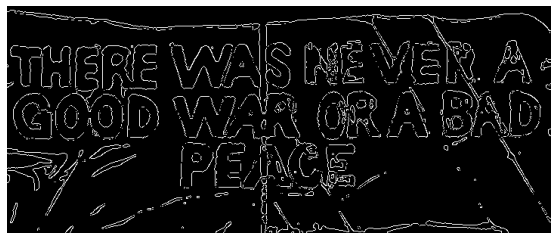

In [50]:
#Creating a blurred image of the cropped ROI 
blurred_NI = cv2.GaussianBlur(Cropped_NI, (7,7), 0)

#Applying our binary threshold to make the image black and white ((this helps to segment foreground and background)
#We've ammended the parameters - a threshold of 100 seems to be optimal for this image  
(_, binary_NI) = cv2.threshold(blurred_NI, 100, 255, cv2.THRESH_BINARY)

#apply cv2's canny edge detection (Again, we've manually ammended the parameters) 
canny_NI = cv2.Canny(binary_NI, 80, 150)

jimshow_channel(canny_NI)

In [51]:
#Eek the image is looking quite confused but we'll see how the contours come out 
#Find controus and save them as "contours":
(NI_contours, _) = cv2.findContours(canny_NI.copy(), 
                 cv2.RETR_EXTERNAL,
                 cv2.CHAIN_APPROX_SIMPLE)

In [52]:
# drawing contours on cropped image with thickness of 2 (using copy of cropped image) 
letters_NI = cv2.drawContours(Cropped_NI.copy(), NI_contours, -1, (0,255,0), 2)